<a href="https://colab.research.google.com/github/Vz-3/AP-DS/blob/main/audioFeatureExtraction/FA6-AudioFeatureExtraction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Preparation

Required Packages:
* librosa & pyAudioAnalysis for music and audio analysis.
* mathplotlib and/or seaborn for visuallization

In [25]:
from google.colab import drive
drive.mount('/content/drive')

wavDittoPath = '/content/drive/MyDrive/datasets/raw_files/Ditto_chorus.wav'
wavColdManPath =  '/content/drive/MyDrive/datasets/raw_files/ColdColdColdman_chorus.wav'

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
!pip install --upgrade pyAudioAnalysis

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.3/41.3 MB 33.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pyAudioAnalysis: filename=pyAudioAnalysis-0.3.14-py3-none-any.whl size=41264374 sha256=1d3699e26c4d69cdeae975373173abe0cee8b00d6b146f6f480a67d0905171f7
  Stored in directory: /root/.cache/pip/wheels/a7/54/73/fa830689c2440d2c81ff175c60e374930ad1607a8881e0f43f
Successfully built pyAudioAnalysis


In [28]:
%matplotlib inline
import librosa
import pyAudioAnalysis
import IPython.display as IPod
import sklearn
import matplotlib.pyplot as plt
from csv import writer

Documentation for Quick Access:
* https://librosa.org/doc/latest/generated/librosa.display.waveshow.html#librosa.display.waveshow
* https://matplotlib.org/


Raw chorus files:
*   Ditto - NewJeans - 1 min - K-Pop
*   Cold Cold Cold Man - Saint Motel - 1 min - Alt Rock

In [11]:
#There's two ways to use Audio. The easier method is to use librosa.load
#to load the waveform and store sampling rate without explictly putting the
#two variables inside .Audio (Simply loading the path without extracting the
#variables will throw an error). The other one is to explictly data=waveform,
#rate=sampling_rate.
dittoWave , dittoSamplingRate = librosa.load(wavDittoPath)
IPod.Audio(wavDittoPath)

In [26]:
coldWave, coldSamplingRate = librosa.load(wavColdManPath)
IPod.Audio(data=coldWave, rate=coldSamplingRate)

Waveform Visualization

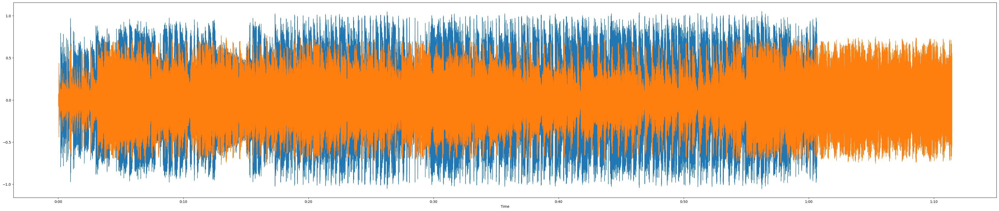

In [32]:
plt.figure(figsize=(50, 10))
librosa.display.waveshow(dittoWave, sr=dittoSamplingRate)

librosa.display.waveshow(coldWave, sr=coldSamplingRate)

Spectogram Visualization

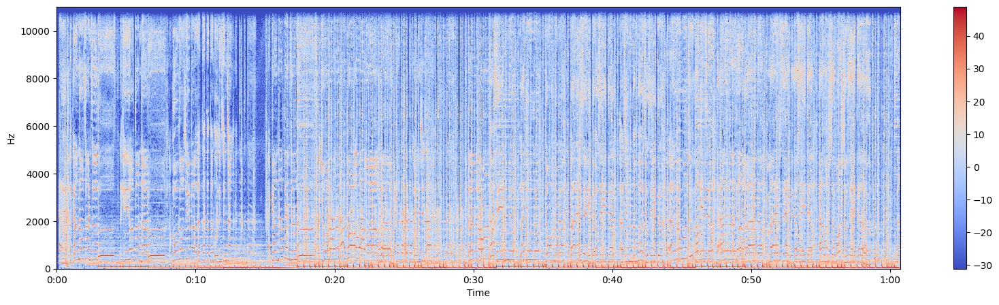

In [35]:
#converting data into short-time fourier transform (<-insert-definition and reason why->)
stftDitto = librosa.stft(dittoWave)
stftCold = librosa.stft(coldWave)

#then we convert the stft data into decibel-scaled spectogram
dbDitto = librosa.amplitude_to_db(abs(stftDitto))
dbCold = librosa.amplitude_to_db(abs(stftCold))

#Displaying Spectogram for Ditto first.
plt.figure(figsize=(20, 5))
librosa.display.specshow(dbDitto, sr=dittoSamplingRate, x_axis='time', y_axis='hz')
plt.colorbar()

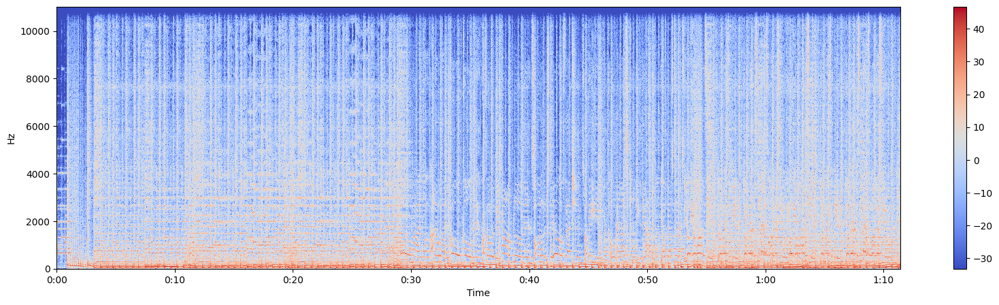

In [38]:
#Displaying Spectogram for Cold Cold Cold Man.
plt.figure(figsize=(20, 5))
librosa.display.specshow(dbCold, sr=coldSamplingRate, x_axis='time', y_axis='hz')
plt.colorbar()


Displaying

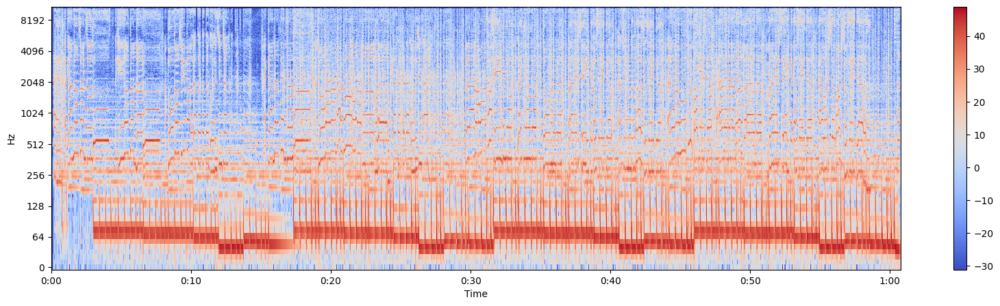

In [40]:
#Log Axis
plt.figure(figsize=(20, 5))
librosa.display.specshow(dbDitto, sr=dittoSamplingRate, x_axis='time', y_axis='log')
plt.colorbar()

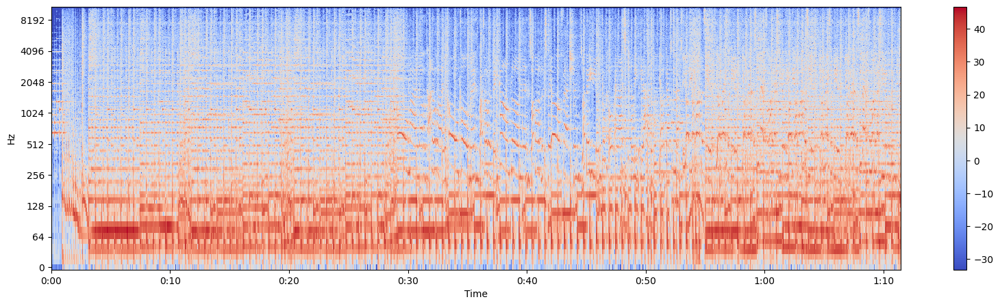

In [39]:
#Log Axis
plt.figure(figsize=(20, 5))
librosa.display.specshow(dbCold, sr=coldSamplingRate, x_axis='time', y_axis='log')
plt.colorbar()

# Feature Extraction


References:
* https://towardsdatascience.com/extract-features-of-music-75a3f9bc265d
